In [1]:
import pickle
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

with open('C:/Users/usuario/Desktop/TFG/DATASET/daily_por_tramo.pkl', 'rb') as f:
    daily_por_tramo = pickle.load(f)

In [2]:
daily_por_tramo[4][0].columns

Index(['HS10_min', 'HS10_mean', 'HS10_max', 'HS20_min', 'HS20_mean',
       'HS20_max', 'HS30_min', 'HS30_mean', 'HS30_max', 'HS40_min',
       'HS40_mean', 'HS40_max', 'HS50_min', 'HS50_mean', 'HS50_max',
       'HS60_min', 'HS60_mean', 'HS60_max', 'TS30_min', 'TS30_mean',
       'TS30_max', 'TA_min', 'TA_mean', 'TA_max', 'HA_min', 'HA_mean',
       'HA_max', 'id_nodo', 'MNDT', 'MXDT', 'MCD', 'CMNDT', 'CMXDT',
       'litros_diarios', 'temp_mean', 'temp_max', 'temp_min', 'humedad_mean',
       'humedad_max', 'humedad_min', 'radiacion', 'precipitacion', 'eto'],
      dtype='object')

Tramo 4-1: 2 ruptura(s) → 3 fase(s)


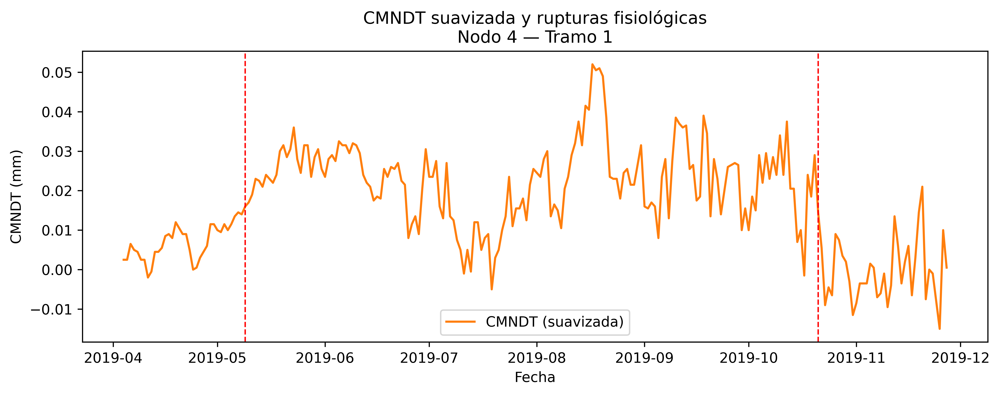

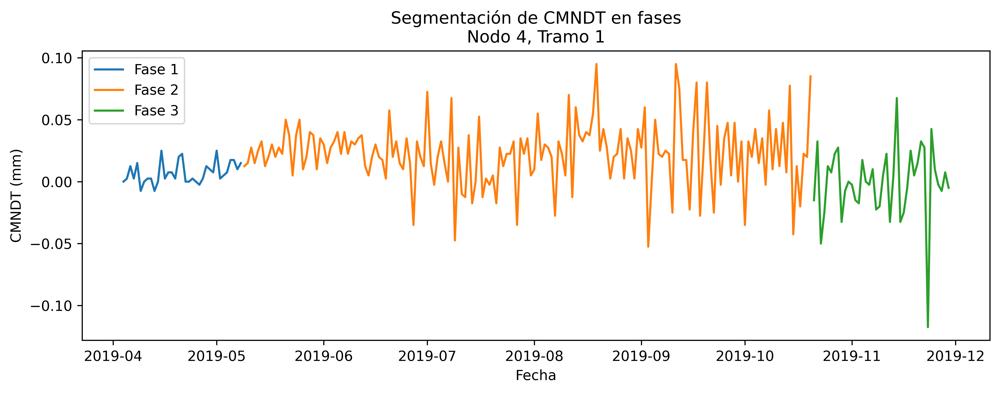

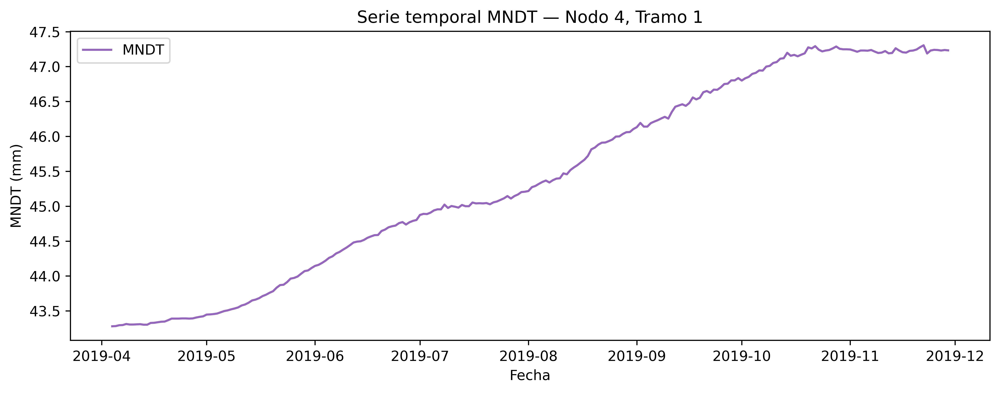

Tramo 4-2: 4 ruptura(s) → 5 fase(s)


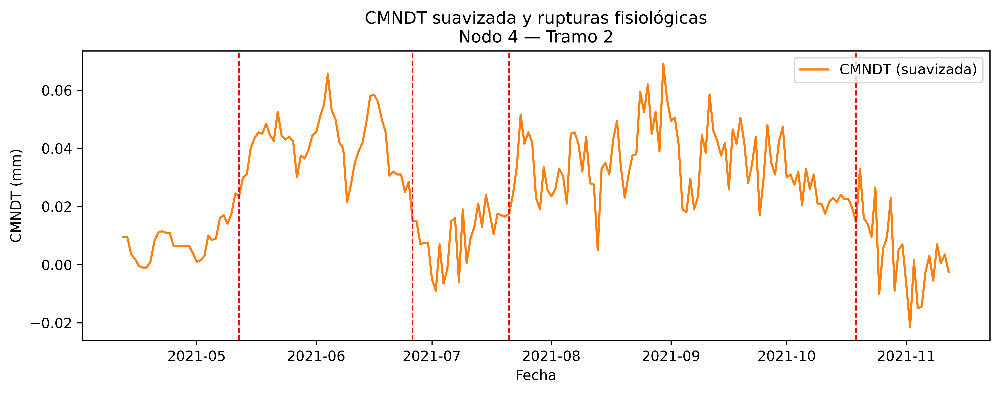

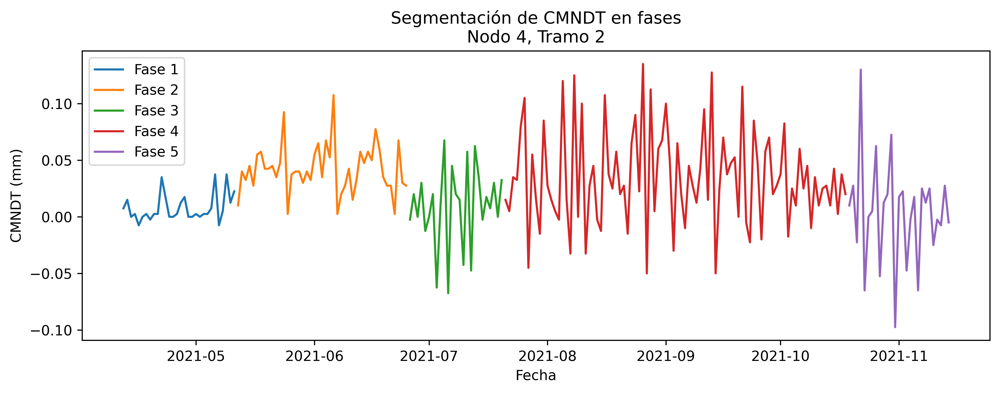

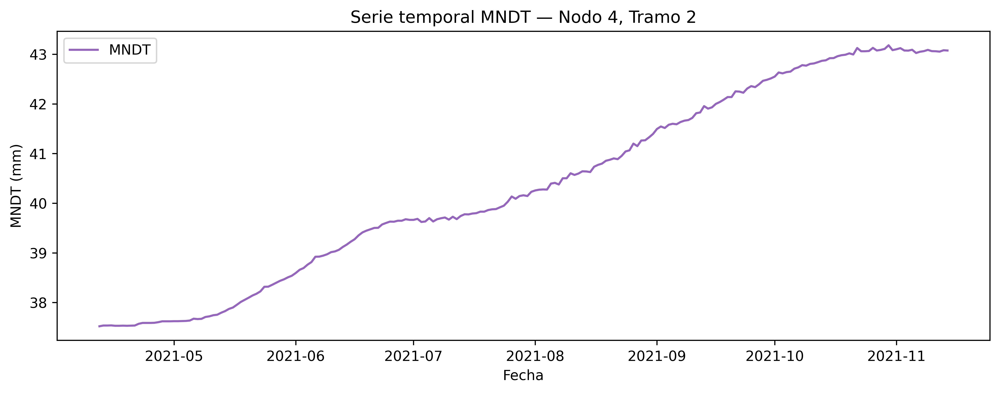

Tramo 6-4: 2 ruptura(s) → 3 fase(s)


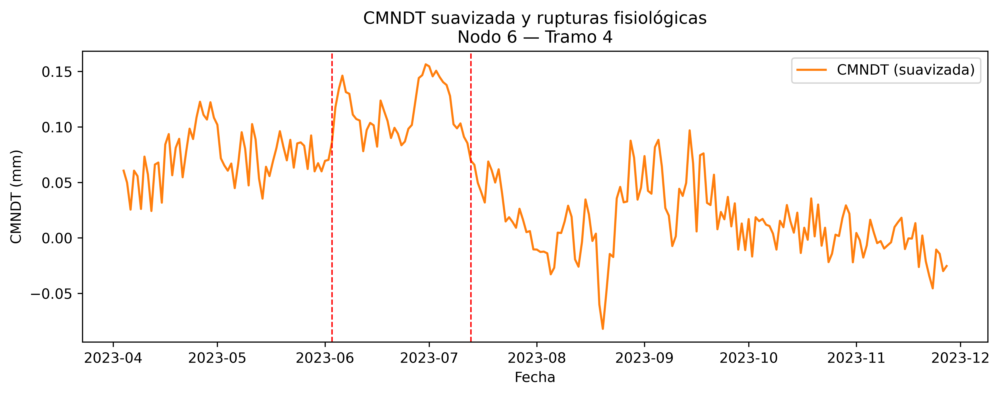

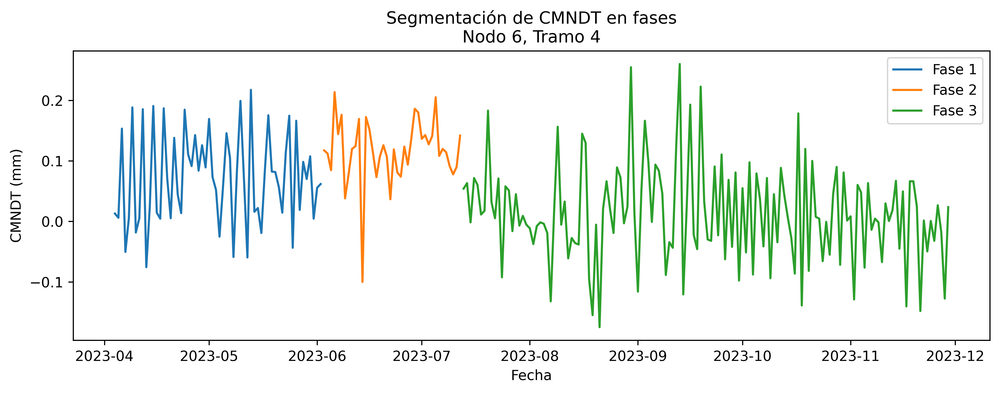

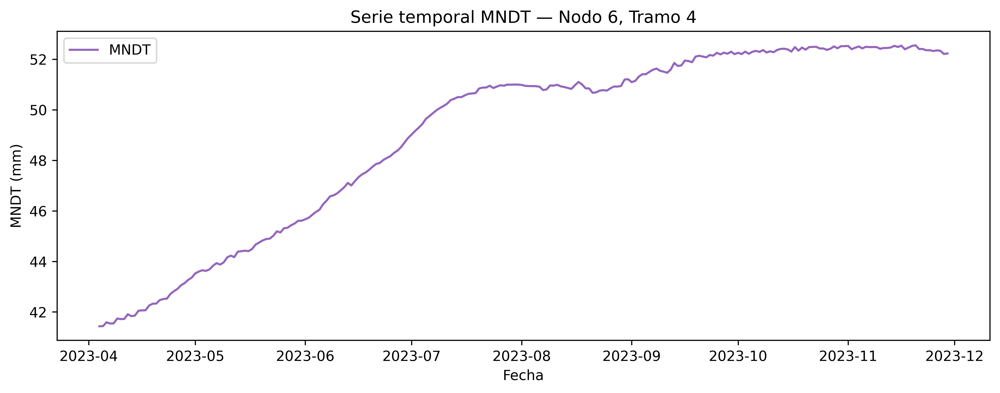

In [10]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import ruptures as rpt

# ───────── CONFIGURACIÓN ─────────
VENTANA_MEDIA_MOVIL = 5
PENALIZACION = 8

# ───────── LISTA DE PERIODOS SELECCIONADOS ─────────
periodos_objetivo = [
    (4, 1),
    (4, 2),
    (6, 4),
]

# ───────── BUCLE POR PERIODOS SELECCIONADOS ─────────
for nodo, tramo_idx in periodos_objetivo:

    df_seg = daily_por_tramo[nodo][tramo_idx].copy()

    # ⬅️ FILTRO solo para el periodo 0 del nodo 4
    if tramo_idx == 0 and nodo == 4:
        df_seg = df_seg[df_seg.index >= '2018-06-01']

    cmndt_raw = df_seg['CMNDT'].dropna()
    cmndt_suavizada = cmndt_raw.rolling(window=VENTANA_MEDIA_MOVIL, center=True).mean().dropna()

    if len(cmndt_suavizada) < 40:
        print(f"Tramo muy corto (nodo {nodo}, tramo {tramo_idx}) — omitido")
        continue

    arr = cmndt_suavizada.values.reshape(-1, 1)
    algo = rpt.Pelt(model="rbf").fit(arr)
    bkps = algo.predict(pen=PENALIZACION)
    bkps = bkps[:-1]  # quitar el final

    n_rupturas = len(bkps)
    fechas_bkp = [cmndt_suavizada.index[b] for b in bkps]

    print(f"Tramo {nodo}-{tramo_idx}: {n_rupturas} ruptura(s) → {n_rupturas+1} fase(s)")

    # ───── Inicializar columna 'fase' ─────
    df_seg['fase'] = np.nan

    # ───── Asignación dinámica de fases ─────
    if n_rupturas == 0:
        df_seg['fase'] = 1
    else:
        segmentos = [0] + bkps  # índices de corte
        for i in range(len(segmentos) - 1):
            start = cmndt_suavizada.index[segmentos[i]]
            end = cmndt_suavizada.index[segmentos[i + 1] - 1]
            mask = (df_seg.index >= start) & (df_seg.index <= end)
            df_seg.loc[mask, 'fase'] = i + 1
        if bkps[-1] < len(cmndt_suavizada):
            start = cmndt_suavizada.index[bkps[-1]]
            df_seg.loc[df_seg.index >= start, 'fase'] = len(segmentos)

    # Eliminar nulos de 'fase' y convertir a int
    df_seg = df_seg.dropna(subset=['fase'])
    df_seg['fase'] = df_seg['fase'].astype(int)

    # ───── GRAFICO 1: CMNDT SUAVIZADA CON RUPTURAS ─────
    plt.figure(figsize=(10, 4), dpi=600)
    plt.plot(cmndt_suavizada.index, cmndt_suavizada, label='CMNDT (suavizada)', color='C1')
    for fecha in fechas_bkp:
        plt.axvline(fecha, color='red', linestyle='--', linewidth=1)
    plt.title(f"CMNDT suavizada y rupturas fisiológicas\nNodo {nodo} — Tramo {tramo_idx}")
    plt.ylabel("CMNDT (mm)")
    plt.xlabel("Fecha")
    plt.style.use('default')
    plt.legend()
    plt.tight_layout()
    plt.show()

    # ───── GRAFICO 2: FASES COLOREADAS EN CMNDT ORIGINAL ─────
    plt.figure(figsize=(10, 4), dpi=600)
    for fase_val in sorted(df_seg['fase'].unique()):
        df_fase = df_seg[df_seg['fase'] == fase_val]
        plt.plot(df_fase.index, df_fase['CMNDT'], label=f'Fase {fase_val}')
    plt.title(f"Segmentación de CMNDT en fases\nNodo {nodo}, Tramo {tramo_idx}")
    plt.ylabel("CMNDT (mm)")
    plt.xlabel("Fecha")
    plt.style.use('default')
    plt.legend()
    plt.tight_layout()
    plt.show()

    # ───── GRAFICO 3: MNDT COMPLETA ─────
    plt.figure(figsize=(10, 4), dpi=600)
    plt.plot(df_seg.index, df_seg['MNDT'], label='MNDT', color='C4')
    plt.title(f"Serie temporal MNDT — Nodo {nodo}, Tramo {tramo_idx}")
    plt.ylabel("MNDT (mm)")
    plt.xlabel("Fecha")
    plt.legend()
    plt.style.use('default')
    plt.tight_layout()
    plt.show()


In [4]:
# ───────── CONFIGURAR RENOMBRES ─────────
rename_map = {
    "temp_mean":    "TA_mean",
    "temp_max":     "TA_max",
    "temp_min":     "TA_min",
    "humedad_mean": "HA_mean",
    "humedad_max":  "HA_max",
    "humedad_min":  "HA_min",
}

# ───────── RECORRIDO GLOBAL ─────────
for nodo, lista_dfs in daily_por_tramo.items():
    for i, df in enumerate(lista_dfs):

        # --- 1) eliminar columnas TA_* y HA_* existentes
        cols_drop = [c for c in df.columns if c.startswith("TA") or c.startswith("HA")]
        if cols_drop:
            df = df.drop(columns=cols_drop)

        # --- 2) renombrar según mapa (si alguna existe en este DF)
        rename_local = {old: new for old, new in rename_map.items() if old in df.columns}
        df = df.rename(columns=rename_local)

        # --- 3) guardar de vuelta en la lista
        daily_por_tramo[nodo][i] = df

print("Renombrado completado y columnas TA/HA antiguas eliminadas.")

Renombrado completado y columnas TA/HA antiguas eliminadas.


In [2]:
daily_por_tramo[4][1].columns

Index(['HS10_min', 'HS10_mean', 'HS10_max', 'HS20_min', 'HS20_mean',
       'HS20_max', 'HS30_min', 'HS30_mean', 'HS30_max', 'HS40_min',
       'HS40_mean', 'HS40_max', 'HS50_min', 'HS50_mean', 'HS50_max',
       'HS60_min', 'HS60_mean', 'HS60_max', 'TS30_min', 'TS30_mean',
       'TS30_max', 'id_nodo', 'MNDT', 'MXDT', 'MCD', 'CMNDT', 'CMXDT',
       'litros_diarios', 'TA_mean', 'TA_max', 'TA_min', 'HA_mean', 'HA_max',
       'HA_min', 'radiacion', 'precipitacion', 'eto', 'fase'],
      dtype='object')

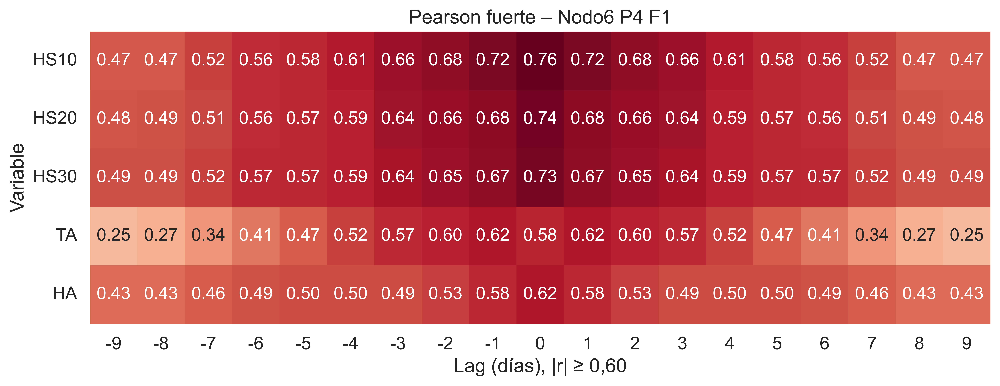

Guardado: heatmaps_fases_filtrados\pearson_p4_f1_thr60.png


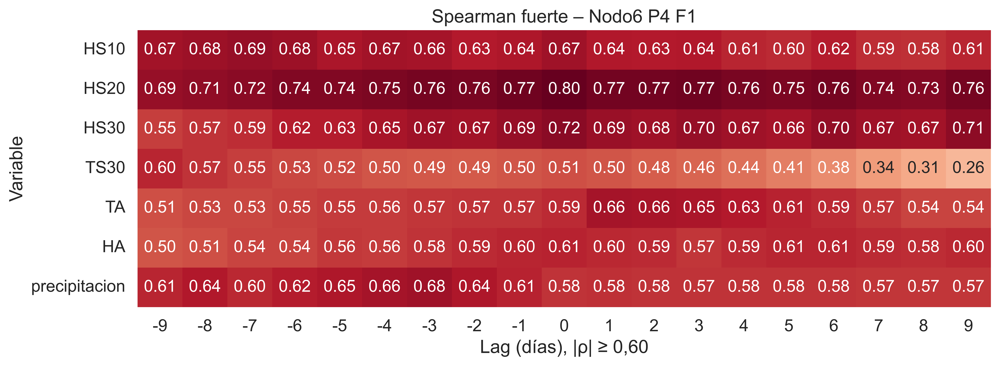

Guardado: heatmaps_fases_filtrados\spearman_p4_f1_thr60.png


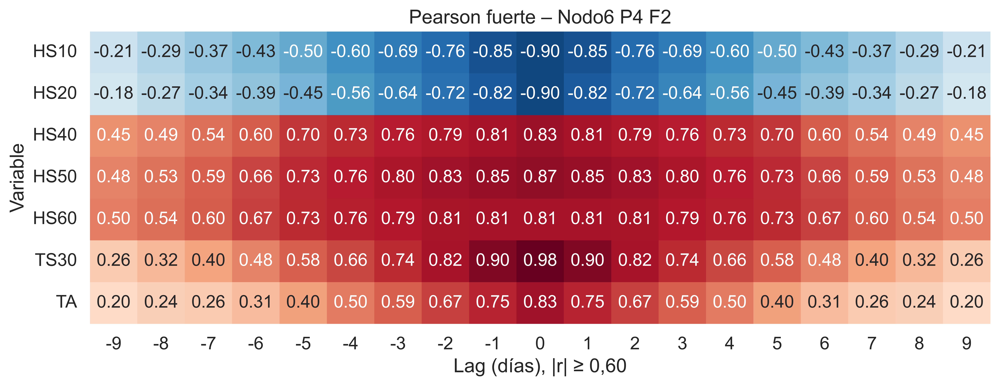

Guardado: heatmaps_fases_filtrados\pearson_p4_f2_thr60.png


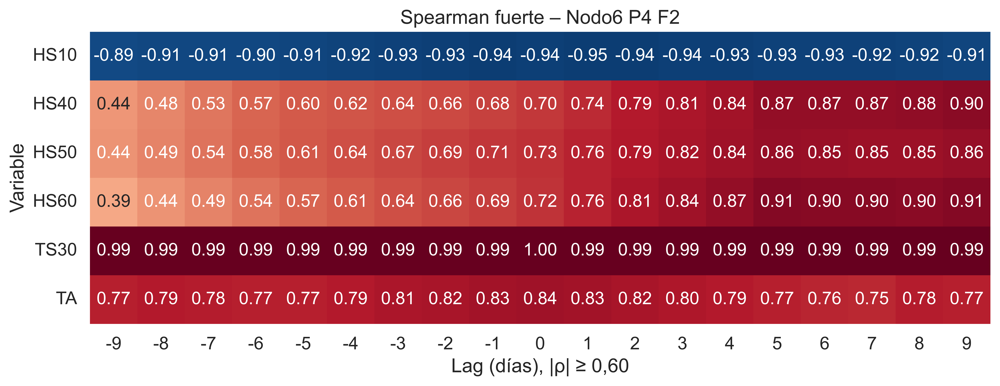

Guardado: heatmaps_fases_filtrados\spearman_p4_f2_thr60.png


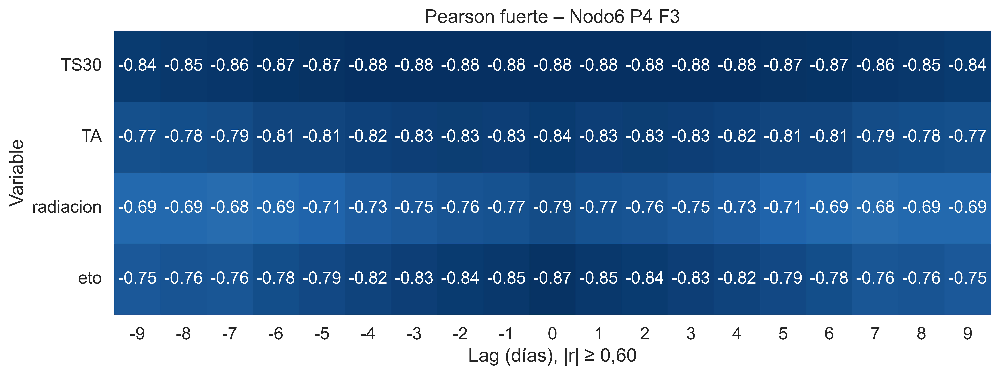

Guardado: heatmaps_fases_filtrados\pearson_p4_f3_thr60.png


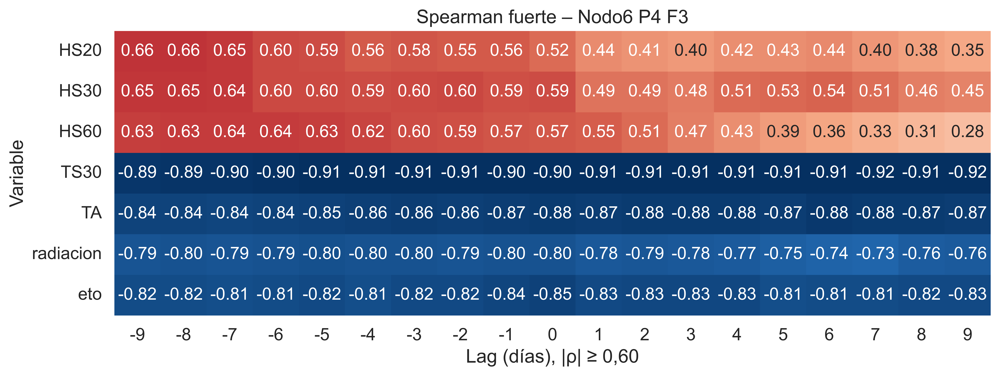

Guardado: heatmaps_fases_filtrados\spearman_p4_f3_thr60.png


In [4]:
# ───────────────────────── LIBRERÍAS ─────────────────────────
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os

from statsmodels.tsa.stattools import ccf
from scipy.stats import spearmanr

# ─────────────────── CONFIGURACIÓN GENERAL ───────────────────
nodo        = 6              # nodo a procesar
periodos    = [4]         # índices de tramos en daily_por_tramo
max_lag     = 10             # ±(max_lag-1) = 9 => 19 columnas
lags        = np.arange(-max_lag + 1, max_lag)
UMBRAL      = 0.60

# Ajuste de aspecto
sns.set(font_scale=1.2)
ANNOT_KWS = dict(size=13)     # tamaño números en celdas

# ──────────────────── FUNCIONES AUXILIARES ───────────────────
def compute_ccf(x, y, max_lag):
    """CCF (Pearson) centrada: devuelve vector de 2·max_lag-1."""
    vals = ccf(x, y, adjusted=False)
    out  = np.full(2 * max_lag - 1, np.nan)
    for i, lag in enumerate(range(-max_lag + 1, max_lag)):
        if lag >= 0 and lag < len(vals):
            out[i] = vals[lag]
        elif lag < 0 and -lag < len(vals):
            out[i] = vals[-lag]
    return out

def compute_spearman_ccf(x, y, max_lag):
    """CCF tipo Spearman (rangos) para los mismos lags."""
    res = []
    for lag in range(-max_lag + 1, max_lag):
        if lag < 0:
            x1, y1 = x[:lag], y[-lag:]
        elif lag > 0:
            x1, y1 = x[lag:], y[:-lag]
        else:
            x1, y1 = x, y
        res.append(spearmanr(x1, y1)[0] if len(x1) >= 3 else np.nan)
    return np.array(res)

# ───────────────────── DIRECTORIO DE SALIDA ───────────────────
OUT_DIR = "heatmaps_fases_filtrados"
os.makedirs(OUT_DIR, exist_ok=True)

# ─────────────────────── PROCESAMIENTO ───────────────────────
for periodo in periodos:
    df = daily_por_tramo[nodo][periodo].copy()

    # 1) Relleno inicial de NaNs en 'fase'
    primer_valor = df['fase'].dropna().iloc[0]
    df['fase'] = df['fase'].fillna(primer_valor)

    # 2) Re-etiquetado de fases en el periodo 2
    if periodo == 2:
        df['fase'] = df['fase'].replace({2:2,3:2,4:2,5:3})

    fases = sorted(df['fase'].dropna().unique())

    # Variables numéricas a analizar
    excl = {'MNDT','CMNDT','CMXDT','MXDT','MCD','id_nodo','fase'}
    vars_num = [
        c for c in df.columns
        if c not in excl
           and np.issubdtype(df[c].dtype, np.number)
    ]

    for fase in fases:
        sub = df[df['fase']==fase]

        pearson_mat, spearman_mat = [], []
        names_p, names_s          = [], []

        # calcula CCFs y filtra por umbral
        for var in vars_num:
            x = sub[var].values
            y = sub['MNDT'].values
            m = ~np.isnan(x)&~np.isnan(y)
            x,y = x[m], y[m]
            if len(x)<max_lag+1: continue

            ccf_p = compute_ccf(x,y,max_lag)
            ccf_s = compute_spearman_ccf(x,y,max_lag)

            if np.nanmax(np.abs(ccf_p))>=UMBRAL:
                pearson_mat.append(ccf_p); names_p.append(var)
            if np.nanmax(np.abs(ccf_s))>=UMBRAL:
                spearman_mat.append(ccf_s); names_s.append(var)

        # si no hay nada, saltar
        if not names_p and not names_s:
            print(f"Periodo {periodo} Fase {fase}: SIN variables ≥ {UMBRAL}")
            continue

        # construye DataFrames
        if names_p:
            df_p = pd.DataFrame(pearson_mat,
                                index=names_p,
                                columns=lags)
        if names_s:
            df_s = pd.DataFrame(spearman_mat,
                                index=names_s,
                                columns=lags)

        # ——— Agrupamiento por variable base ———
        def agrupa_y_media(df_in):
            # agrupa filas por nombre base antes del '_'
            groups = {}
            for full in df_in.index:
                base = full.rsplit('_',1)[0]
                groups.setdefault(base, []).append(full)
            # construye df con una fila por base
            out = {
                base: df_in.loc[rows].mean(axis=0)
                for base,rows in groups.items()
            }
            return pd.DataFrame(out).T

        if names_p:
            df_p = agrupa_y_media(df_p)
            df_p = df_p.loc[df_p.abs().max(axis=1) >= UMBRAL]  # ← FILTRO AQUÍ
        if names_s:
            df_s = agrupa_y_media(df_s)
            df_s = df_s.loc[df_s.abs().max(axis=1) >= UMBRAL]  # ← FILTRO AQUÍ


        # ——— Graficar por separado ———
        # 1) Pearson
        if names_p:
            plt.figure(figsize=(12, max(4, df_p.shape[0]*0.5)), dpi=1000)
            sns.heatmap(df_p,
                        annot=True, annot_kws=ANNOT_KWS, fmt=".2f",
                        center=0, cmap='RdBu_r',cbar=False)
            plt.title(f"Pearson fuerte – Nodo{nodo} P{periodo} F{int(fase)}")
            plt.xlabel("Lag (días), |r| ≥ 0,60")
            plt.ylabel("Variable")
            plt.yticks(rotation=0)
            fp = os.path.join(OUT_DIR,
                              f"pearson_p{periodo}_f{int(fase)}_thr{int(UMBRAL*100)}.png")
            plt.savefig(fp, dpi=1000)
            plt.show()
            print("Guardado:", fp)

        # 2) Spearman
        if names_s:
            plt.figure(figsize=(12, max(4, df_s.shape[0]*0.5)), dpi=1000)
            sns.heatmap(df_s,
                        annot=True, annot_kws=ANNOT_KWS, fmt=".2f",
                        center=0, cmap='RdBu_r',cbar=False)
            plt.title(f"Spearman fuerte – Nodo{nodo} P{periodo} F{int(fase)}")
            plt.xlabel("Lag (días), |ρ| ≥ 0,60")
            plt.ylabel("Variable")
            plt.yticks(rotation=0)
            fs = os.path.join(OUT_DIR,
                              f"spearman_p{periodo}_f{int(fase)}_thr{int(UMBRAL*100)}.png")
            plt.savefig(fs, dpi=1000)
            plt.show()
            print("Guardado:", fs)


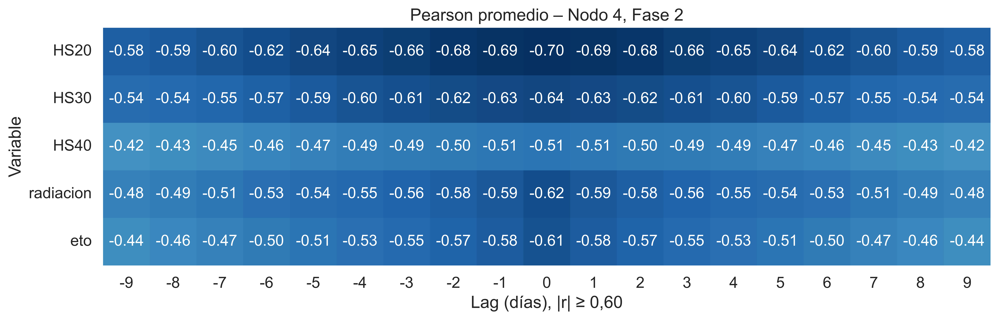

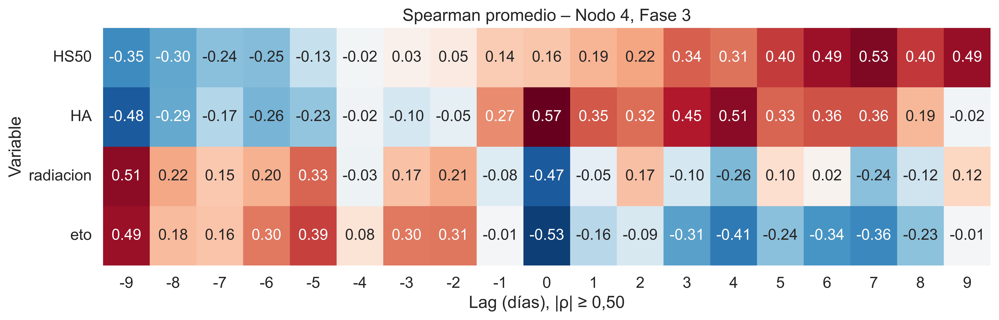

In [5]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
import os

from statsmodels.tsa.stattools import ccf
from scipy.stats import spearmanr
from collections import defaultdict

# ───────── CONFIGURACIÓN ─────────
nodo      = 4
periodos  = [1, 2]
max_lag   = 10             # desfases ±(max_lag−1)=±9
lags      = np.arange(-max_lag+1, max_lag)
UMBRAL    = 0.50

sns.set(font_scale=1.2)
ANNOT_KWS = dict(size=13)

# ───────── FUNCIONES AUXILIARES ─────────
def compute_ccf(x, y, max_lag):
    vals = ccf(x, y, adjusted=False)
    out  = np.full(2*max_lag-1, np.nan)
    for i, lag in enumerate(range(-max_lag+1, max_lag)):
        if 0 <= lag < len(vals):
            out[i] = vals[lag]
        elif lag < 0 and -lag < len(vals):
            out[i] = vals[-lag]
    return out

def compute_spearman_ccf(x, y, max_lag):
    res = []
    for lag in range(-max_lag+1, max_lag):
        if lag < 0:
            x1, y1 = x[:lag], y[-lag:]
        elif lag > 0:
            x1, y1 = x[lag:], y[:-lag]
        else:
            x1, y1 = x, y
        res.append(spearmanr(x1, y1)[0] if len(x1) >= 3 else np.nan)
    return np.array(res)

# ───────── ACUMULADORES POR FASE Y VARIABLE VARIANTE ─────────
pearson_dict  = defaultdict(lambda: defaultdict(list))
spearman_dict = defaultdict(lambda: defaultdict(list))

# ───────── RECORRIDO DE PERIODOS Y FASES ─────────
for periodo in periodos:
    df = daily_por_tramo[nodo][periodo].copy()
    # rellenar fases NaN
    prv = df['fase'].dropna().iloc[0]
    df['fase'] = df['fase'].fillna(prv).astype(int)
    # re-etiquetar fases en periodo 2
    if periodo == 2:
        df['fase'] = df['fase'].replace({2:2,3:2,4:2,5:3})
    fases = sorted(df['fase'].unique())

    excl = {'MNDT','CMNDT','CMXDT','MXDT','MCD','id_nodo','fase'}
    vars_num = [c for c in df.columns if c not in excl and np.issubdtype(df[c].dtype, np.number)]

    for fase in fases:
        sub = df[df['fase']==fase]
        x_base = sub['MNDT'].values

        usar_pearson  = (fase == 2)
        usar_spearman = (fase in (1,3))

        for var in vars_num:
            y = sub[var].values
            mask = (~np.isnan(x_base)) & (~np.isnan(y))
            x, y = x_base[mask], y[mask]
            if len(x) < max_lag+1:
                continue

            if usar_pearson:
                pearson_dict[fase][var].append(compute_ccf(x, y, max_lag))
            if usar_spearman:
                spearman_dict[fase][var].append(compute_spearman_ccf(x, y, max_lag))

# ───────── PROMEDIO, AGRUPAMIENTO POR BASE Y GRAFICADO ─────────
OUT_DIR = "heatmaps_promedio_por_fase"
os.makedirs(OUT_DIR, exist_ok=True)

for fase in sorted(set(pearson_dict) | set(spearman_dict)):

    # --- Pearson en fase 2 ---
    if fase in pearson_dict:
        # Agrupar variantes por variable base
        base_dict = defaultdict(list)
        for var, arrs in pearson_dict[fase].items():
            base = var.rsplit('_',1)[0]
            base_dict[base].extend(arrs)

        # Calcular promedio por base
        df_avg = pd.DataFrame({
            base: np.nanmean(np.vstack(arrs), axis=0)
            for base, arrs in base_dict.items()
        }, index=lags).T

        # filtrar por umbral sobre el promedio
        df_plot = df_avg.loc[df_avg.abs().max(axis=1) >= UMBRAL]
        if not df_plot.empty:
            plt.figure(figsize=(12, max(4, df_plot.shape[0]*0.5)), dpi=1000)
            sns.heatmap(df_plot, annot=True, fmt=".2f", center=0,
                        cmap='RdBu_r', cbar=False, annot_kws=ANNOT_KWS)
            plt.yticks(rotation=0)
            plt.title(f"Pearson promedio – Nodo {nodo}, Fase {fase}")
            plt.xlabel("Lag (días), |r| ≥ 0,60"); plt.ylabel("Variable")
            plt.tight_layout()
            fp = os.path.join(OUT_DIR, f"pearson_prom_fase{fase}.png")
            plt.savefig(fp, dpi=1000)
            plt.show()

    # --- Spearman en fases 1 y 3 ---
    if fase in spearman_dict:
        base_dict = defaultdict(list)
        for var, arrs in spearman_dict[fase].items():
            base = var.rsplit('_',1)[0]
            base_dict[base].extend(arrs)

        df_avg = pd.DataFrame({
            base: np.nanmean(np.vstack(arrs), axis=0)
            for base, arrs in base_dict.items()
        }, index=lags).T

        df_plot = df_avg.loc[df_avg.abs().max(axis=1) >= UMBRAL]
        if not df_plot.empty:
            plt.figure(figsize=(12, max(4, df_plot.shape[0]*0.5)), dpi=1000)
            sns.heatmap(df_plot, annot=True, fmt=".2f", center=0,
                        cmap='RdBu_r', cbar=False, annot_kws=ANNOT_KWS)
            plt.yticks(rotation=0)
            plt.title(f"Spearman promedio – Nodo {nodo}, Fase {fase}")
            plt.xlabel("Lag (días), |ρ| ≥ 0,50"); plt.ylabel("Variable")
            plt.tight_layout()
            fs = os.path.join(OUT_DIR, f"spearman_prom_fase{fase}.png")
            plt.savefig(fs, dpi=1000)
            plt.show()
